<a href="https://colab.research.google.com/github/MonikaLamba/Tensor-Flow-/blob/main/tensor_flow_day_4_DATA_GENERATOR.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [10]:
!wget https://storage.googleapis.com/tensorflow-1-public/course2/week3/horse-or-human.zip

--2024-06-28 04:42:23--  https://storage.googleapis.com/tensorflow-1-public/course2/week3/horse-or-human.zip
Resolving storage.googleapis.com (storage.googleapis.com)... 64.233.181.207, 142.251.184.207, 173.194.193.207, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|64.233.181.207|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 149574867 (143M) [application/zip]
Saving to: ‘horse-or-human.zip.3’

horse-or-human.zip. 100%[===================>] 142.65M   141MB/s    in 1.0s    

2024-06-28 04:42:24 (141 MB/s) - ‘horse-or-human.zip.3’ saved [149574867/149574867]



In [12]:
#Unzip the dataset
import zipfile
local_zip = './horse-or-human.zip.3'
zip_ref = zipfile.ZipFile(local_zip, 'r')
zip_ref.extractall('./horse-or-human')
zip_ref.close()

In [13]:
import os
#Directory with our training horse pictures
train_horse_dir = os.path.join('./horse-or-human/horses')








In [14]:
#Directory with our training human pictures
train_human_dir = os.path.join('./horse-or-human/humans')
train_horse_names = os.listdir(train_horse_dir)
print(train_horse_names[:10])

train_human_names = os.listdir(train_human_dir)
print(train_human_names[:10])


['horse20-8.png', 'horse12-4.png', 'horse25-9.png', 'horse39-2.png', 'horse26-0.png', 'horse21-6.png', 'horse41-4.png', 'horse37-5.png', 'horse22-9.png', 'horse09-8.png']
['human04-26.png', 'human07-13.png', 'human07-19.png', 'human08-19.png', 'human09-30.png', 'human09-26.png', 'human14-27.png', 'human02-25.png', 'human17-25.png', 'human03-24.png']


In [16]:
print('total training horse images:', len(os.listdir(train_horse_dir)))
print('total training human images:', len(os.listdir(train_human_dir)))

total training horse images: 500
total training human images: 527


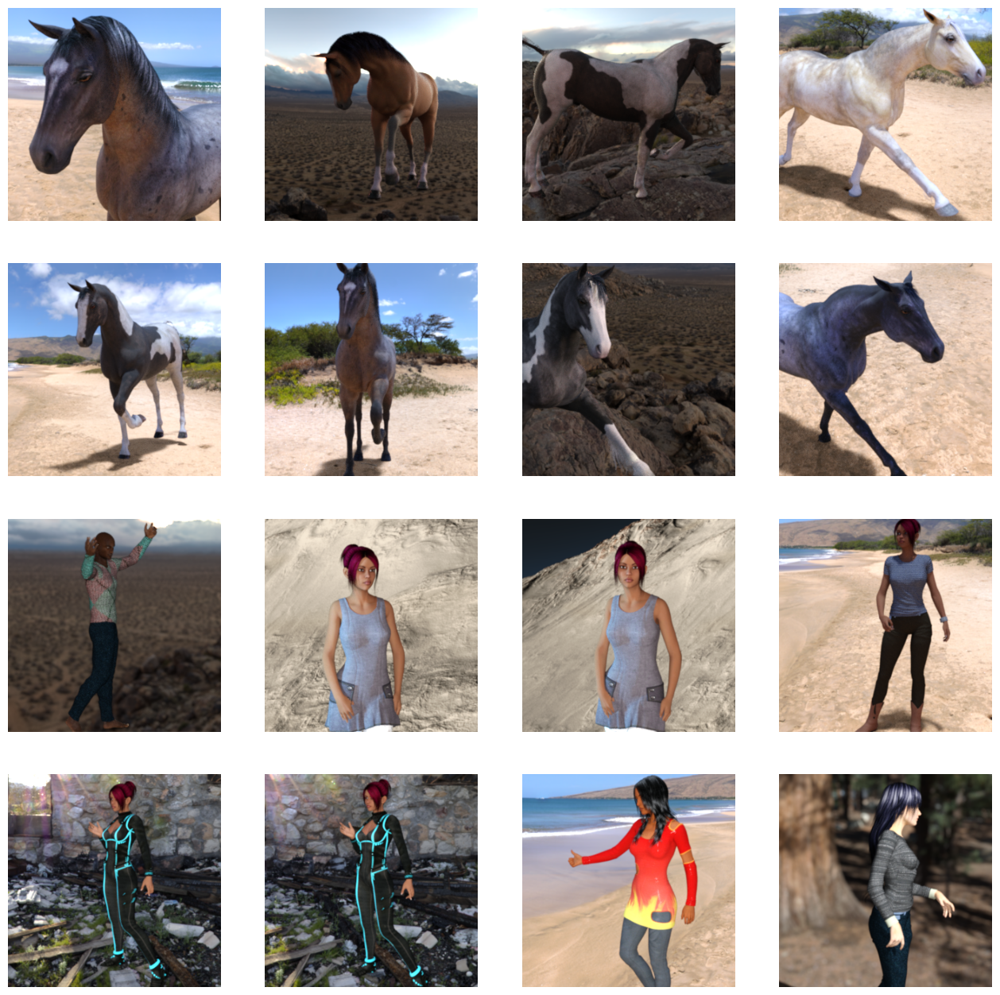

In [22]:

%matplotlib inline

import matplotlib.pyplot as plt
import matplotlib.image as mpimg
#Parameters for our graph; we'll output images in a 4x4 configuration
nrows = 4
ncols = 4
#Index for iterating over images
pic_index = 0
#Now, display a batch of 8 horse and 8 human pictures. You can rerun the cell to see a fresh batch each time:
#Set up matplotlib fig, and size it to fit 4x4 pics
fig = plt.gcf()
fig.set_size_inches(ncols * 4, nrows * 4)

pic_index += 8
next_horse_pix = [os.path.join(train_horse_dir, fname)
for fname in train_horse_names[pic_index-8:pic_index]]
next_human_pix = [os.path.join(train_human_dir, fname)
for fname in train_human_names[pic_index-8:pic_index]]

for i, img_path in enumerate(next_horse_pix+next_human_pix):
# Set up subplot; subplot indices start at 1
 sp = plt.subplot(nrows, ncols, i + 1)
 sp.axis('Off') # Don't show axes (or gridlines)

 img = mpimg.imread(img_path)
 plt.imshow(img)

plt.show()

In [23]:
import tensorflow as tf


model = tf.keras.models.Sequential([
# Note the input shape is the desired size of the image 300x300 with 3 bytes color
    # This is the first convolution
tf.keras.layers.Conv2D(16, (3,3), activation='relu', input_shape=(300, 300, 3)),
tf.keras.layers.MaxPooling2D(2, 2),
    # The second convolution
tf.keras.layers.Conv2D(32, (3,3), activation='relu'),
tf.keras.layers.MaxPooling2D(2,2),
    # The third convolution
tf.keras.layers.Conv2D(64, (3,3), activation='relu'),
tf.keras.layers.MaxPooling2D(2,2),
    # The fourth convolution
tf.keras.layers.Conv2D(64, (3,3), activation='relu'),
tf.keras.layers.MaxPooling2D(2,2),
    # The fifth convolution
tf.keras.layers.Conv2D(64, (3,3), activation='relu'),
tf.keras.layers.MaxPooling2D(2,2),
    # Flatten the results to feed into a DNN
tf.keras.layers.Flatten(),
# 512 neuron hidden layer
tf.keras.layers.Dense(512, activation='relu'),
# Only 1 output neuron. It will contain a value from 0-1 where 0 for 1 class ('horses') and 1 for the other ('humans')
tf.keras.layers.Dense(1, activation='sigmoid')
])



In [24]:
model.summary()


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 298, 298, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2  (None, 149, 149, 16)      0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 147, 147, 32)      4640      
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 73, 73, 32)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 71, 71, 64)        18496     
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 35, 35, 64)        0

In [26]:
from tensorflow.keras.optimizers import RMSprop

model.compile(loss='binary_crossentropy',
              optimizer=RMSprop(learning_rate=0.001),
              metrics=['accuracy'])

In [27]:

from tensorflow.keras.preprocessing.image import ImageDataGenerator
#All images will be rescaled by 1./255
train_datagen = ImageDataGenerator(rescale=1/255)
#Flow training images in batches of 128 using train_datagen generator
train_generator = train_datagen.flow_from_directory(
'./horse-or-human/', # This is the source directory for training images
target_size=(300, 300), # All images will be resized to 300x300
batch_size=128,
# Since we use binary_crossentropy loss, we need binary labels
class_mode='binary')


Found 1027 images belonging to 2 classes.


In [28]:
history = model.fit(
      train_generator,
      steps_per_epoch=8,
      epochs=15,
      verbose=1)

Epoch 1/15
8/8 [==============================] - 94s 11s/step - loss: 0.7073 - accuracy: 0.5328
Epoch 2/15
8/8 [==============================] - 89s 11s/step - loss: 0.7041 - accuracy: 0.6952
Epoch 3/15
8/8 [==============================] - 93s 11s/step - loss: 0.7150 - accuracy: 0.6352
Epoch 4/15
8/8 [==============================] - 100s 12s/step - loss: 0.6301 - accuracy: 0.6652
Epoch 5/15
8/8 [==============================] - 92s 11s/step - loss: 0.4449 - accuracy: 0.8687
Epoch 6/15
8/8 [==============================] - 92s 11s/step - loss: 0.3061 - accuracy: 0.8598
Epoch 7/15
8/8 [==============================] - 92s 11s/step - loss: 0.1445 - accuracy: 0.9466
Epoch 8/15
8/8 [==============================] - 91s 11s/step - loss: 0.5275 - accuracy: 0.8376
Epoch 9/15
8/8 [==============================] - 101s 12s/step - loss: 0.1729 - accuracy: 0.9455
Epoch 10/15
8/8 [==============================] - 93s 11s/step - loss: 0.0827 - accuracy: 0.9666
Epoch 11/15
8/8 [==========

In [33]:
import numpy as np
from google.colab import files
from keras.preprocessing import image

uploaded = files.upload()

for fn in uploaded.keys():

  # predicting images
  path = '/content/' + fn
  img = image.load_img(path, target_size=(300, 300))
  x = image.img_to_array(img)
  x /= 255
  x = np.expand_dims(x, axis=0)

  images = np.vstack([x])
  classes = model.predict(images, batch_size=10)
  print(classes[0])

  if classes[0]>0.5:
    print(fn + " is a human")
  else:
    print(fn + " is a horse")

Saving h1h1.png to h1h1.png
1/1 [==============================] - 0s 51ms/step
[0.99996835]
h1h1.png is a human


In [34]:
import numpy as np
import random
from tensorflow.keras.preprocessing.image import img_to_array, load_img



Define a new Model that will take an image as input, and will output
intermediate representations for all layers in the previous model after
the first.


In [35]:
successive_outputs = [layer.output for layer in model.layers[1:]]
visualization_model = tf.keras.models.Model(inputs = model.input, outputs = successive_outputs)


In [36]:
# Prepare a random input image from the training set.
horse_img_files = [os.path.join(train_horse_dir, f) for f in train_horse_names]
human_img_files = [os.path.join(train_human_dir, f) for f in train_human_names]
img_path = random.choice(horse_img_files + human_img_files)

img = load_img(img_path, target_size=(300, 300)) # this is a PIL image
x = img_to_array(img) # Numpy array with shape (300, 300, 3)
x = x.reshape((1,) + x.shape) # Numpy array with shape (1, 300, 300, 3)


In [37]:
#Scale by 1/255
x /= 255


In [38]:
#Run the image through the network, thus obtaining all
#intermediate representations for this image.
successive_feature_maps = visualization_model.predict(x)


1/1 [==============================] - 0s 136ms/step


In [39]:
# These are the names of the layers, so you can have them as part of the plot
layer_names = [layer.name for layer in model.layers[1:]]


<ipython-input-50-a93ea6a7cd03>:19: RuntimeWarning: invalid value encountered in cast
  x = np.clip(x, 0, 255).astype('uint8')
<ipython-input-50-a93ea6a7cd03>:26: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(scale * n_features, scale))


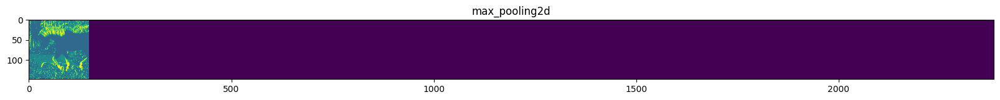

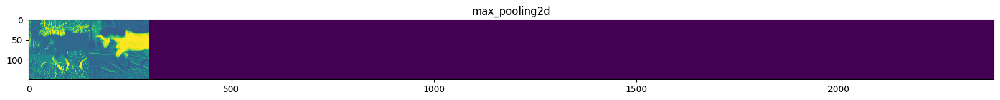

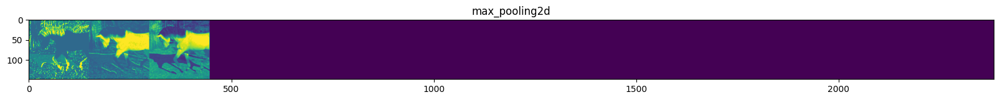

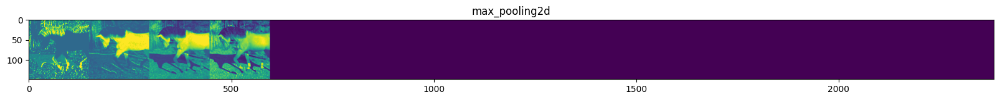

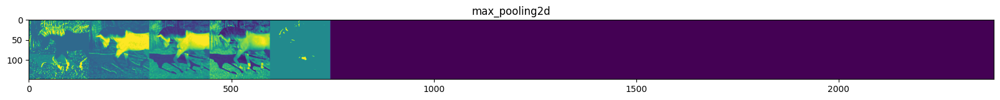

...

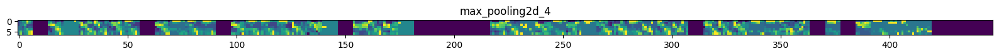

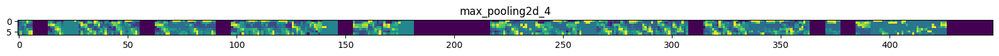

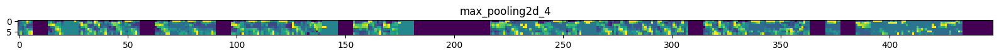

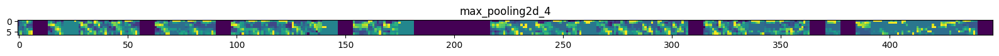

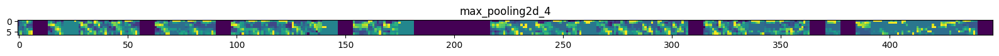

In [50]:
#Display the representations
for layer_name, feature_map in zip(layer_names, successive_feature_maps):
  if len(feature_map.shape) == 4:

# Just do this for the conv / maxpool layers, not the fully-connected layers
   n_features = feature_map.shape[-1] # number of features in feature map

# The feature map has shape (1, size, size, n_features)
   size = feature_map.shape[1]

# Tile the images in this matrix
   display_grid = np.zeros((size, size * n_features))
   for i in range(n_features):
    x = feature_map[0, :, :, i]
    x -= x.mean()
    x /= x.std()
    x *= 64
    x += 128
    x = np.clip(x, 0, 255).astype('uint8')

# Tile each filter into this big horizontal grid
    display_grid[:, i * size : (i + 1) * size] = x

# Display the grid
    scale = 20. / n_features
    plt.figure(figsize=(scale * n_features, scale))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')




In [ ]:
import os, signal
os.kill(os.getpid(),signal.SIGKILL)